In [1]:
# link: https://github.com/liyaguang/DCRNN
import numpy as np
import pandas as pd
import json
import math, shapely

In [2]:
import os
import pandas as pd
import geopandas as gpd
import tqdm
import datetime
import numpy as np
import matplotlib.pyplot as plt
from cartoframes.viz import *
from tqdm import notebook

In [3]:
def ensure_dir(dir_path):
    """Make sure the directory exists, if it does not exist, create it.

    Args:
        dir_path (str): directory path
    """
    if not os.path.exists(dir_path):
        os.makedirs(dir_path)

In [4]:
import os
import datetime
# link: https://github.com/liyaguang/DCRNN
import numpy as np
import pandas as pd
import json

dataset_name = 'SEOULWK'
outputdir = f'../Bigscity-LibCity/raw_data/{dataset_name}'
ensure_dir(outputdir)
dataname = outputdir+f'/{dataset_name}'

P_SEQ = 6
Q_SEQ = 6

In [5]:
sorted(os.listdir('../dataprocess/seouldata'))

['floating-population-2017-a20.csv',
 'floating-population-2017-a30.csv',
 'floating-population-2017-a40.csv',
 'floating-population-2017-a50.csv',
 'floating-population-2017-a60.csv',
 'floating-population-2017-total.csv',
 'floating-population-2018-a20.csv',
 'floating-population-2018-a30.csv',
 'floating-population-2018-a40.csv',
 'floating-population-2018-a50.csv',
 'floating-population-2018-a60.csv',
 'floating-population-2018-total.csv',
 'local_people_area.geojson',
 'seoul_link_network.geojson',
 'speed-2017.csv',
 'speed-2018.csv',
 'station_coordinate.json',
 'subway-data-off-2017.csv',
 'subway-data-off-2018.csv',
 'subway-data-on-2017.csv',
 'subway-data-on-2018.csv',
 'subway_distances.csv',
 'volume_data_2017.csv',
 'volume_data_2018.csv',
 'volume_data_edit_2017.csv',
 'volume_data_edit_2018.csv',
 'vsensor_locations.geojson']

In [6]:
def imputed_df(df):
    data = df.values
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            if data[i, j] == 0:
                val1 = 0
                val2 = 0
                loop = 0
                while val1 == 0:
                    loop += 24*7
                    if i - loop < 0:
                        break
                    val1 = data[i - loop, j]
                loop = 0
                while val2 == 0:
                    loop += 24*7
                    if i + loop >= data.shape[0]:
                        val2 = val1
                        break
                    val2 = data[i + loop, j]
                if val1 == 0:
                    val1 = val2
                data[i, j] = (val1 + val2) / 2
                
    df = pd.DataFrame(data, columns=df.columns, index=df.index)
    return df

In [7]:
popu_df = pd.read_csv('../dataprocess/seouldata/floating-population-2017-total.csv', index_col=0)
popu_df = imputed_df(popu_df)

In [8]:
popu_df.index = pd.to_datetime(popu_df.index)

In [10]:
popu_df.shape

(8760, 19153)

In [11]:
area_gdf = gpd.read_file('../dataprocess/seouldata/local_people_area.geojson')
area_gdf.crs = 'epsg:4326'
area_gdf = area_gdf.to_crs('epsg:5181')

In [12]:
x1, y1, x2, y2 = 188720, 441440, 210760, 463480
map_boundary = shapely.geometry.box(x1, y1, x2, y2, ccw=True)
map_gdf = gpd.GeoDataFrame(geometry = [map_boundary])
map_gdf.crs = 'epsg:5181'

In [13]:
Map([
    Layer(area_gdf),
    Layer(map_gdf, basic_style(opacity=.5))
])

In [14]:
def organize_lte_cell(road_map_boundary, w=64, h=64):
    bx1, by1, bx2, by2 = road_map_boundary.bounds
    
    grid_width  = (bx2 - bx1) / w
    grid_height = (by2 - by1) / h
    
    x0, y0 = bx1, by1
    cell_idx, cells = [], []
    for j in range(h):
        for i in range(w):
            x1, x2 = x0+i*grid_width, x0+(i+1)*grid_width
            y1, y2 = y0+j*grid_height, y0+(j+1)*grid_height

            tbox = (x1, y1, x2, y2)
            cell = shapely.geometry.box(*tbox, ccw=True)
            cells.append(cell)
            cell_idx.append('{},{}'.format(j, i))

    lte_cell_gdf = gpd.GeoDataFrame(index=range(len(cells)), geometry=cells, crs='epsg:5181')
    lte_cell_gdf['grid_idx'] = cell_idx
    
    return lte_cell_gdf

In [15]:
population_grid_gdf = organize_lte_cell(map_boundary)
population_grid_gdf.crs='epsg:5181'
population_grid_gdf.to_file(dataname + '_grid_64x64_5181.geojson')
population_grid_gdf.to_crs('epsg:4326').to_file(dataname + '_grid_64x64.geojson')

In [16]:
Layer(population_grid_gdf, basic_style(opacity=.5))

In [17]:
if os.path.isfile(dataname + '_clip_transform.npy'):
    A = np.load(dataname + '_clip_transform.npy')
else:
    print('lte cell clip and calculate regional proportion...')
    A = np.zeros((len(population_grid_gdf), len(area_gdf)), dtype=np.float32)
    for i, item_1 in tqdm.tqdm(population_grid_gdf.iterrows(), total=len(population_grid_gdf)):
        cgdf = gpd.clip(area_gdf[area_gdf.intersects(item_1.geometry)], item_1.geometry)
        for j, item_2 in cgdf.iterrows():
            A[i, j] = item_2.geometry.area
    np.dump(A, dataname + '_clip_transform.npy')

lte cell clip and calculate regional proportion...


100%|██████████████████████████████████████████████████████████████████████████████| 4096/4096 [00:14<00:00, 288.16it/s]


In [18]:
# popu_df.diff().values
popu_df.values

array([[ 638.,  563., 1580., ..., 2170.,  999.,   34.],
       [ 605.,  545., 1518., ..., 1173.,  940.,   33.],
       [ 604.,  560., 1607., ..., 1116.,  965.,   32.],
       ...,
       [ 517.,  335., 1122., ..., 4420., 2278.,  295.],
       [ 554.,  319., 1043., ..., 3788., 1852.,  254.],
       [ 595.,  469.,  910., ..., 4157., 1763.,   96.]])

In [19]:
train_popu_values = (popu_df.values / area_gdf.area.values) @ A.T
means = train_popu_values.mean(0)[np.newaxis, :]
stds = train_popu_values.std(0)[np.newaxis, :]

TH = 2
ntrain_popu_values = (train_popu_values - means) / stds
ntrain_popu_values = np.nan_to_num(ntrain_popu_values, .5)
ntrain_popu_values[(ntrain_popu_values > TH)] = TH
# ntrain_popu_values[(-TH < ntrain_popu_values) & (ntrain_popu_values < TH)] = 0
ntrain_popu_values[(ntrain_popu_values < -TH)] = -TH
ntrain_popu_values = (ntrain_popu_values + TH) / (2*TH)

/tmp/ipykernel_2452952/257185287.py:6: RuntimeWarning: invalid value encountered in divide
  ntrain_popu_values = (train_popu_values - means) / stds


(array([ 676291., 2183397., 4980788., 4938027., 4373211., 8001314.,
        3461684., 3040138., 2288157., 1937953.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

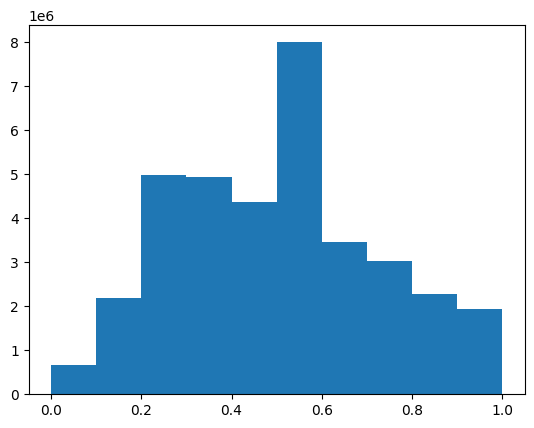

In [20]:
plt.hist(ntrain_popu_values.flatten())

In [21]:
npopu_df = pd.DataFrame(ntrain_popu_values, index=pd.to_datetime(popu_df.index), columns=population_grid_gdf['grid_idx'])
npopu_df.to_csv(dataname + '_normalized_population.csv')

# VAE LSTM

In [22]:
import os
import pandas as pd
import geopandas as gpd
import tqdm
import datetime
import numpy as np
import matplotlib.pyplot as plt
from cartoframes.viz import *
from tqdm import notebook

In [23]:
import os
import datetime

os.environ['CUDA_VISIBLE_DEVICES'] = '0'

In [24]:
population = npopu_df.values.reshape(-1, 64, 64, 1)

In [25]:
population.max(), population.min(), population.mean()

(1.0, 0.0, 0.4974140789905432)

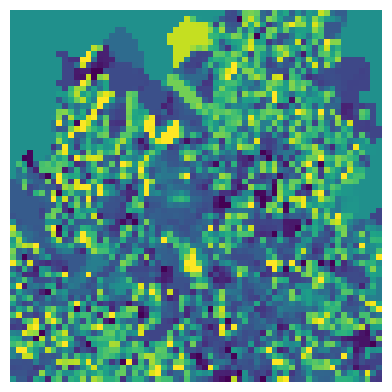

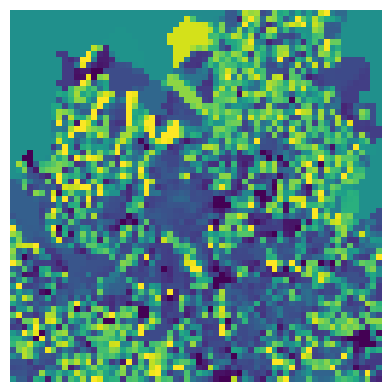

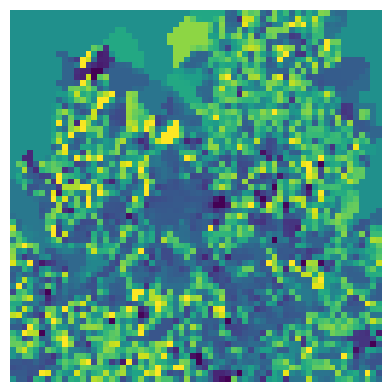

In [26]:
for i in range(0, 12, 4):
    plt.matshow(population[i], vmin=0, vmax=1)
    plt.gca().invert_yaxis()
    plt.axis('off')
    plt.show()

# Extract TrainData and conduct VAE Pre-Training

In [27]:
train_data = population

In [28]:
mask = (1 - 1*(np.sum(population == .5, 0) > 8000))[np.newaxis, ...].astype(np.float32)

In [29]:
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, backend as K
from tensorflow.keras.models import Model
from tensorflow.keras.losses import binary_crossentropy, mean_absolute_error, mean_squared_error

# Define the input shape and latent space dimensions
input_shape = (64, 64, 1)  # Shape of the 64x64 grayscale input
latent_dim = 64  # Dimension of the latent space (can be tuned)

# Sampling function to sample from the latent space
def sampling(args):
    z_mean, z_log_var = args
    batch = K.shape(z_mean)[0]
    dim = K.int_shape(z_mean)[1]
    epsilon = K.random_normal(shape=(batch, dim))
    return z_mean + K.exp(0.5 * z_log_var) * epsilon

def construct_vae():
    # Encoder network
    
    inputs = layers.Input(shape=input_shape, name='encoder_input')    
    x = layers.Conv2D(32, 3, activation='relu', padding='same', name='conv_1')(inputs)
    x = layers.MaxPooling2D(pool_size=(2, 2), name='pool_1')(x)  # Now 32x32
    x = layers.Conv2D(64, 3, activation='relu', padding='same', name='conv_2')(x)
    x = layers.MaxPooling2D(pool_size=(2, 2), name='pool_2')(x)  # Now 16x16
    x = layers.Conv2D(128, 3, activation='relu', padding='same', name='conv_3')(x)
    x = layers.MaxPooling2D(pool_size=(2, 2), name='pool_3')(x)  # Now 8x8
    x = layers.Conv2D(256, 3, activation='relu', padding='same', name='conv_4')(x)
    x = layers.MaxPooling2D(pool_size=(2, 2), name='pool_4')(x)  # Now 4x4
    x = layers.Flatten(name='flatten')(x)
    x = layers.Dense(128, activation='relu', name='dense_encoder')(x)

    # Latent space
    z_mean = layers.Dense(latent_dim, name='z_mean')(x)
    z_log_var = layers.Dense(latent_dim, name='z_log_var')(x)

    # Sampling latent space
    z = layers.Lambda(sampling, output_shape=(latent_dim,), name='z')([z_mean, z_log_var])

    # Decoder network
    decoder_input = layers.Input(shape=(latent_dim,), name='decoder_input')
    x = layers.Dense(4 * 4 * 256, activation='relu', name='dense_decoder')(decoder_input)
    x = layers.Reshape((4, 4, 256), name='reshape_decoder')(x)
    x = layers.Conv2DTranspose(256, 3, activation='relu', padding='same', name='deconv_1')(x)
    x = layers.UpSampling2D(size=(2, 2), name='upsample_1')(x)  # Now 8x8
    x = layers.Conv2DTranspose(128, 3, activation='relu', padding='same', name='deconv_2')(x)
    x = layers.UpSampling2D(size=(2, 2), name='upsample_2')(x)  # Now 16x16
    x = layers.Conv2DTranspose(64, 3, activation='relu', padding='same', name='deconv_3')(x)
    x = layers.UpSampling2D(size=(2, 2), name='upsample_3')(x)  # Now 32x32
    x = layers.Conv2DTranspose(32, 3, activation='relu', padding='same', name='deconv_4')(x)
    x = layers.UpSampling2D(size=(2, 2), name='upsample_4')(x)  # Now 64x64
    outputs = layers.Conv2DTranspose(1, 3, activation='relu', padding='same', name='decoder_output')(x)
    mymask = tf.tile(mask, [tf.shape(outputs)[0], 1, 1, 1])
    outputs = layers.Dense(1,  activation='sigmoid', name='decoder_mask_output')(tf.concat([outputs, mymask], -1))

    # Build encoder and decoder models
    encoder = Model(inputs, [z_mean, z_log_var, z], name='encoder')
    decoder = Model(decoder_input, outputs, name='decoder')

    # VAE model: input -> encoder -> decoder -> output
    vae_outputs = decoder(encoder(inputs)[2])
    vae = Model(inputs, vae_outputs, name='vae')
    print('vae_outputs.shape', vae_outputs.shape)

    # Define the VAE loss (reconstruction loss + KL divergence)
    reconstruction_loss = mean_squared_error(K.flatten(inputs ), K.flatten(vae_outputs )) * np.prod(input_shape)

    kl_loss = 1 + z_log_var - K.square(z_mean) - K.exp(z_log_var)
    kl_loss = -0.5 * K.sum(kl_loss, axis=-1)
    
    vae_loss = K.mean(reconstruction_loss + kl_loss)

    vae.add_loss(vae_loss)
    vae.compile(optimizer='adam')

    # Summary of the VAE
    vae.summary()

    return vae, encoder, decoder


vae, vae_encoder, vae_decoder = construct_vae()

2024-10-09 15:13:24.475773: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-10-09 15:13:24.585385: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-09 15:13:25.575219: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2024-10-09 15:13:25.597633: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2024-10-09 15:13

vae_outputs.shape (None, 64, 64, 1)
Model: "vae"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 encoder_input (InputLayer)     [(None, 64, 64, 1)]  0           []                               
                                                                                                  
 encoder (Functional)           [(None, 64),         928768      ['encoder_input[0][0]']          
                                 (None, 64),                                                      
                                 (None, 64)]                                                      
                                                                                                  
 decoder (Functional)           (None, 64, 64, 1)    1243908     ['encoder[0][2]']                
                                                            

In [30]:
import numpy as np
ensure_dir('model_checkpoint')

vae_model_checkpoint = f'model_checkpoint/vae_{dataset_name}_weights.h5'
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_loss", patience=10, min_delta=1e-6)
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss", patience=5)
model_ckpt = tf.keras.callbacks.ModelCheckpoint(vae_model_checkpoint, save_weights_only=True, \
                save_best_only=True, monitor='val_loss', mode='min', verbose=0)

In [31]:
# # Train the VAE
# vae.fit(train_data, epochs=200, batch_size=64, validation_split=0.25,
#                 callbacks=[early_stopping, model_ckpt, reduce_lr])

In [32]:
vae.load_weights(vae_model_checkpoint)

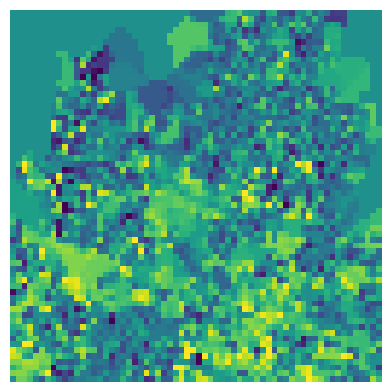

2024-10-09 15:13:26.625578: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8902
2024-10-09 15:13:27.379249: I tensorflow/stream_executor/cuda/cuda_blas.cc:1614] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


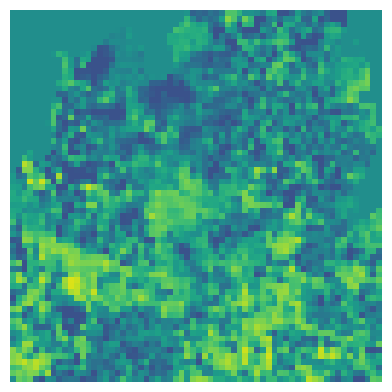

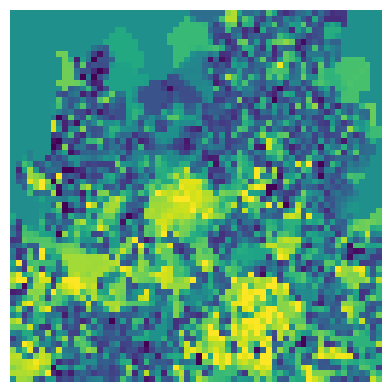

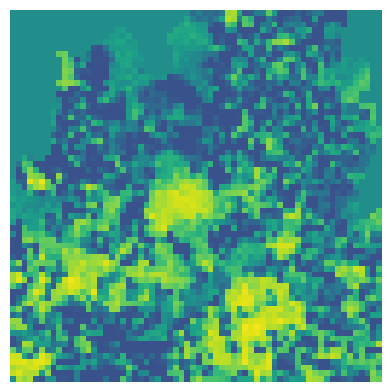

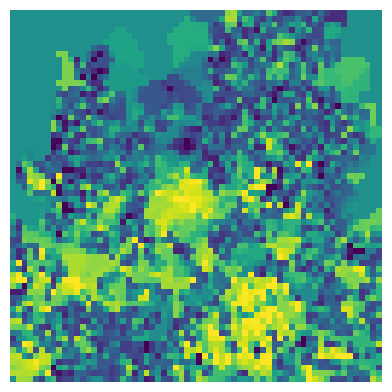

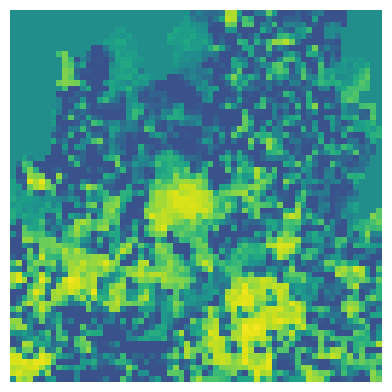

...

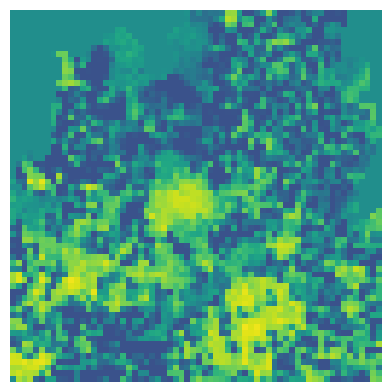

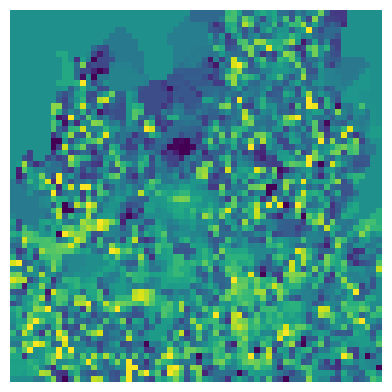

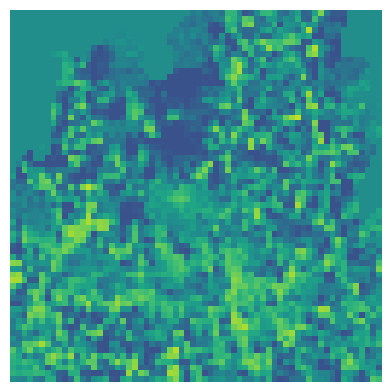

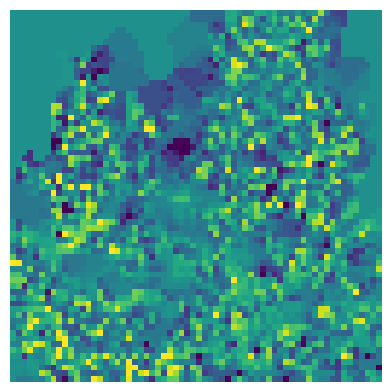

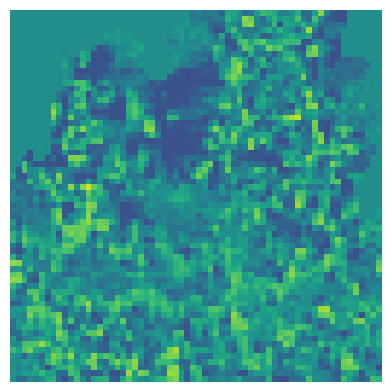

In [33]:
for i in [0, 4, 5, 6, 10, 11]:
    sample = train_data[24*10+9+i:24*10+9+i+1]
    plt.matshow(sample[0], vmin=0, vmax=1)
#     plt.matshow(sample[0, ..., 1]/2 + sample[0, ..., 2], vmin=0, vmax=1)
    plt.gca().invert_yaxis()
    plt.axis('off')
    plt.show()
    
    psample = vae_decoder(vae_encoder(sample)[2])
    plt.matshow(psample[0], vmin=0, vmax=1)
    plt.gca().invert_yaxis()
    plt.axis('off')
    plt.show()

# PCA visualization

In [34]:
# Assuming `y_test` contains the labels for `x_test`
z_mean, _, _ = vae_encoder.predict(population)
from sklearn.decomposition import PCA

# Assuming `z_mean` is the latent representation with 64 dimensions
# Reduce the latent space from 64 dimensions to 2 using PCA
pca = PCA(n_components=2)
z_pca = pca.fit_transform(z_mean)

274/274 [==============================] - 1s 2ms/step


In [35]:
popu_datetime = pd.to_datetime(popu_df.index)

## Seoul ALL

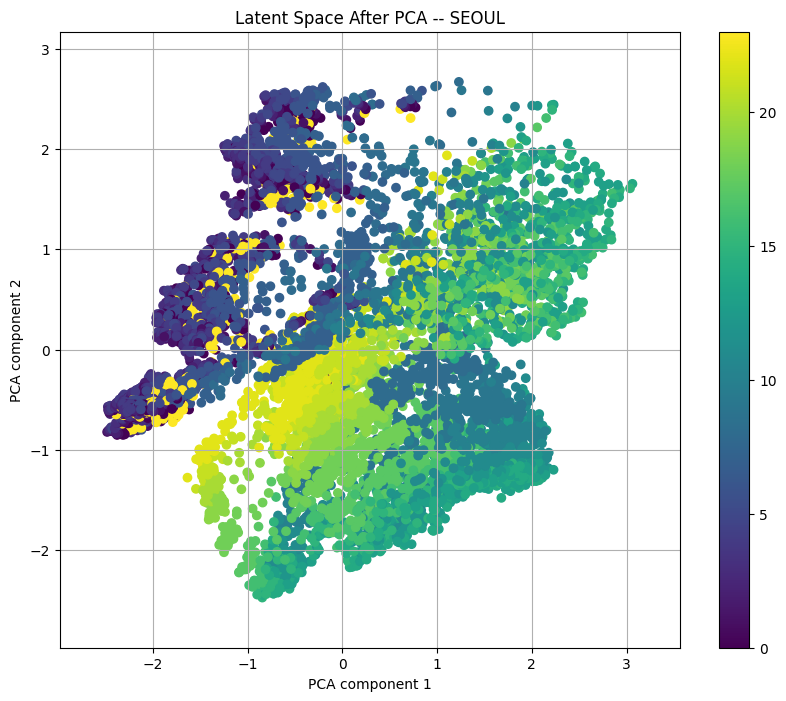

In [36]:
import matplotlib.pyplot as plt

# Replot the reduced latent space
fig1 = plt.figure(figsize=(10, 8))
plt.scatter(z_pca[:, 0], z_pca[:, 1], c=popu_datetime.hour, cmap='viridis')
plt.colorbar()
plt.xlabel("PCA component 1")
plt.ylabel("PCA component 2")
plt.xlim([z_pca[:, 0].min()-.5, z_pca[:, 0].max()+.5])
plt.ylim([z_pca[:, 1].min()-.5, z_pca[:, 1].max()+.5])
plt.grid()
plt.title(f"Latent Space After PCA -- SEOUL")
plt.show()

## Seoul Weekday

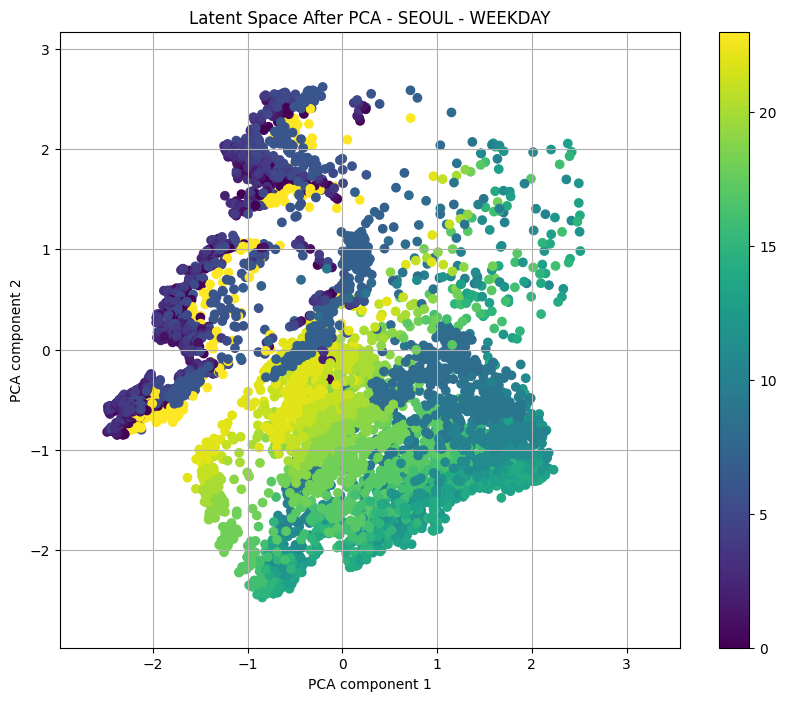

In [37]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Replot the reduced latent space
fig2 = plt.figure(figsize=(10, 8))
# plt.scatter(z_pca[:, 0], z_pca[:, 1], c=pd.to_datetime(popu_df.index[1:]).weekday, cmap='viridis')
cond = popu_datetime.weekday < 5
plt.scatter(z_pca[cond, 0], z_pca[cond, 1], c=popu_datetime[cond].hour, cmap='viridis')
plt.colorbar()
plt.xlabel("PCA component 1")
plt.ylabel("PCA component 2")
plt.xlim([z_pca[:, 0].min()-.5, z_pca[:, 0].max()+.5])
plt.ylim([z_pca[:, 1].min()-.5, z_pca[:, 1].max()+.5])
plt.grid()
plt.title("Latent Space After PCA - SEOUL - WEEKDAY")
plt.show()

/tmp/ipykernel_2452952/2383689982.py:40: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 1, 1])


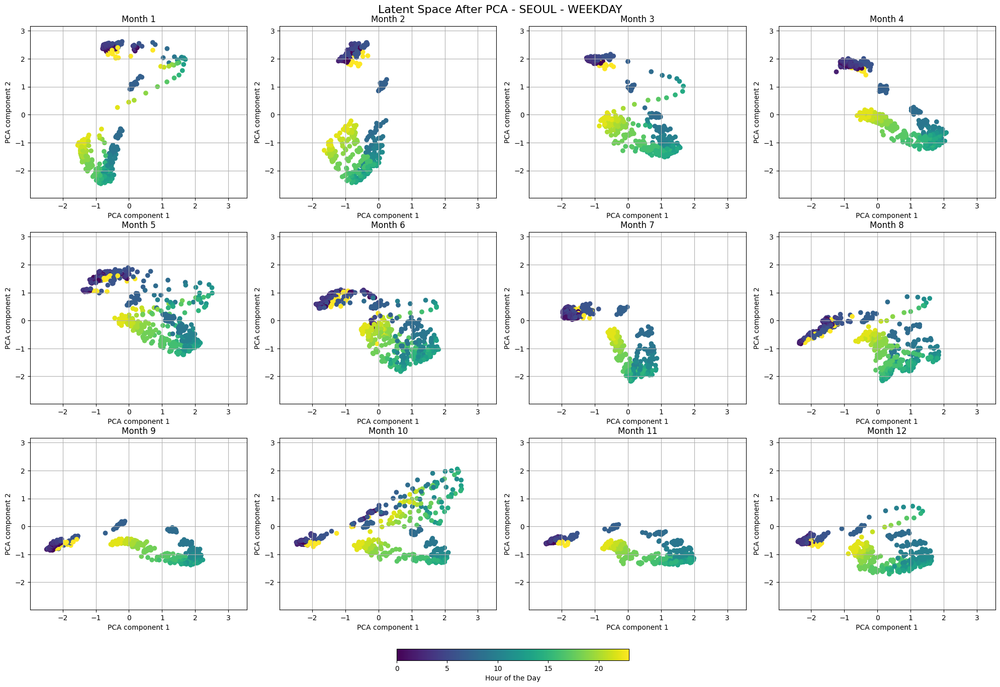

In [38]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import pandas as pd

# Assuming `z_mean` is the latent representation with 64 dimensions
# Reduce the latent space from 64 dimensions to 2 using PCA

# Create a figure with subplots (3 rows, 4 columns) for each month
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

# Loop over each month and plot on the corresponding subplot
for month in range(1, 13):
    # Define the condition for weekdays and the specific month
    cond = (popu_datetime.weekday < 5) & (popu_datetime.month == month)
    
    # Calculate the row and column index for subplots
    row = (month - 1) // 4
    col = (month - 1) % 4
    
    # Scatter plot in the appropriate subplot
    scatter = axes[row, col].scatter(
        z_pca[cond, 0], 
        z_pca[cond, 1], 
        c=popu_datetime[cond].hour, 
        cmap='viridis'
    )
    axes[row, col].set_title(f"Month {month}")
    axes[row, col].set_xlabel("PCA component 1")
    axes[row, col].set_ylabel("PCA component 2")
    axes[row, col].grid(True)
    axes[row, col].set_xlim([z_pca[:, 0].min() - 0.5, z_pca[:, 0].max() + 0.5])
    axes[row, col].set_ylim([z_pca[:, 1].min() - 0.5, z_pca[:, 1].max() + 0.5])

# Add a colorbar that corresponds to all subplots
cbar = fig.colorbar(scatter, ax=axes, orientation='horizontal', fraction=0.02, pad=-0.2)
cbar.set_label('Hour of the Day')

# Adjust layout
plt.suptitle("Latent Space After PCA - SEOUL - WEEKDAY", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

## Seoul Weekend

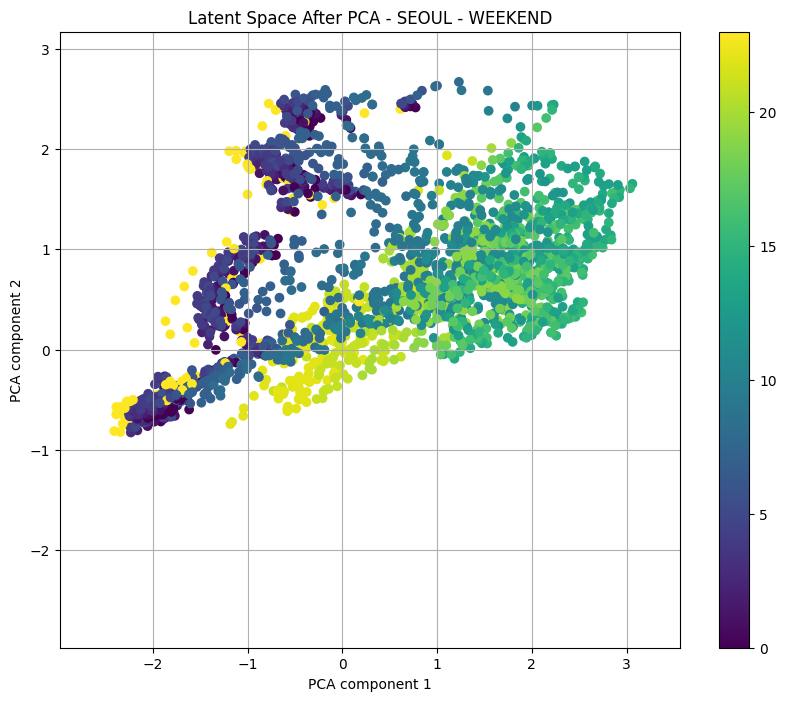

In [39]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA


# Replot the reduced latent space
fig3 = plt.figure(figsize=(10, 8))
# plt.scatter(z_pca[:, 0], z_pca[:, 1], c=pd.to_datetime(popu_df.index[1:]).weekday, cmap='viridis')
cond = popu_datetime.weekday >= 5
plt.scatter(z_pca[cond, 0], z_pca[cond, 1], c=popu_datetime[cond].hour, cmap='viridis')
plt.colorbar()
plt.xlabel("PCA component 1")
plt.ylabel("PCA component 2")
plt.xlim([z_pca[:, 0].min()-.5, z_pca[:, 0].max()+.5])
plt.ylim([z_pca[:, 1].min()-.5, z_pca[:, 1].max()+.5])
plt.grid()
plt.title("Latent Space After PCA - SEOUL - WEEKEND")
plt.show()

/tmp/ipykernel_2452952/2825411205.py:40: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 1, 1])


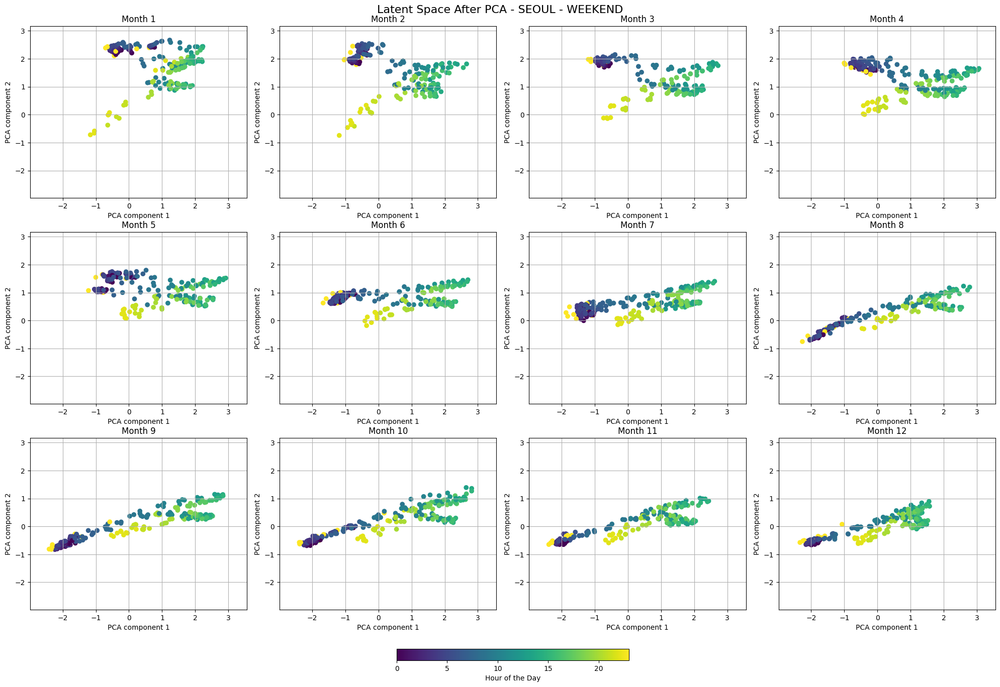

In [40]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import pandas as pd

# Assuming `z_mean` is the latent representation with 64 dimensions
# Reduce the latent space from 64 dimensions to 2 using PCA

# Create a figure with subplots (3 rows, 4 columns) for each month
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

# Loop over each month and plot on the corresponding subplot
for month in range(1, 13):
    # Define the condition for weekdays and the specific month
    cond = (popu_datetime.weekday >= 5) & (popu_datetime.month == month)
    
    # Calculate the row and column index for subplots
    row = (month - 1) // 4
    col = (month - 1) % 4
    
    # Scatter plot in the appropriate subplot
    scatter = axes[row, col].scatter(
        z_pca[cond, 0], 
        z_pca[cond, 1], 
        c=popu_datetime[cond].hour, 
        cmap='viridis'
    )
    axes[row, col].set_title(f"Month {month}")
    axes[row, col].set_xlabel("PCA component 1")
    axes[row, col].set_ylabel("PCA component 2")
    axes[row, col].grid(True)
    axes[row, col].set_xlim([z_pca[:, 0].min() - 0.5, z_pca[:, 0].max() + 0.5])
    axes[row, col].set_ylim([z_pca[:, 1].min() - 0.5, z_pca[:, 1].max() + 0.5])

# Add a colorbar that corresponds to all subplots
cbar = fig.colorbar(scatter, ax=axes, orientation='horizontal', fraction=0.02, pad=-0.2)
cbar.set_label('Hour of the Day')

# Adjust layout
plt.suptitle("Latent Space After PCA - SEOUL - WEEKEND", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

# WK-LSTM

In [41]:
ts = pd.to_datetime(popu_df.index)
wke = np.eye(7); 
hre = np.eye(24);
TE_train = np.concatenate((wke[ts.weekday], hre[ts.hour]), -1)
# train_TE = TE[:train_data.shape[0]]

In [42]:
def seq2instance(data, P, Q):
    num_step = data.shape[0]
    data_type = data.dtype
    num_sample = (num_step - P - Q + 1)
    x = np.zeros(shape = (num_sample, P, *data.shape[1:]))
    y = np.zeros(shape = (num_sample, Q, *data.shape[1:]))
    for i in range(0, num_sample):
        x[i] = data[i : i + P].astype(data_type)
        y[i] = data[i + P : i + P + Q].astype(data_type)
    return x, y

In [43]:
CP_train, CQ_train = seq2instance(population, P_SEQ, Q_SEQ)
TEPQ_train = np.concatenate(seq2instance(TE_train, P_SEQ, Q_SEQ), 1)

In [44]:
from keras.models import Model
from keras.layers import Input, LSTM, Dense

In [45]:
vae_encoder.trainable = False
vae_decoder.trainable = False

In [46]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from keras import layers
from keras.layers import Input, LSTM
from keras.models import Model

class WK_LSTM(tf.keras.layers.Layer):
    def __init__(self, vae_encoder, vae_decoder):
        super().__init__()
        self.model_name = f'WK_LSTM'
        self.vae_encoder = vae_encoder
        self.vae_decoder = vae_decoder
        self.p = P_SEQ
        self.q = Q_SEQ
        self.w = 64
        self.d = 64

        
    def build(self, input_shape):
        self.encoder = LSTM(self.d, return_sequences=True, return_state=True, name='wk_encoder')
        self.decoder = LSTM(self.d, return_sequences=True, return_state=True, name='wk_decoder')

        self.TE_input_layer = keras.models.Sequential([layers.Dense(self.d, activation='relu'),
                                                       layers.Dense(self.d),
                                                       layers.Normalization(-1)])

    def get_config(self):
        config = super().get_config()
        return config

    def call(self, CP, TE):
        # X.shape (batch_size, P, 64, 64, 1)
        # TEQ.shape (batch_size, Q, 31)
        
        CP = tf.reshape(CP, (-1, self.w, self.w, 1))
        CP_emb = self.vae_encoder(CP)[1]
        CP_emb = tf.reshape(CP_emb, (-1, self.p, self.d))
        CP_emb_save = CP_emb

        TE_emb = self.TE_input_layer(TE)
        TEP_emb, TEQ_emb = TE_emb[:, :self.p, :], TE_emb[:, self.p:, :]


        _, state_h, state_c = self.encoder(CP_emb + TEP_emb)
        CQ_emb, _, _ = self.decoder(TEQ_emb, initial_state=(state_h, state_c))
        CQ_emb_save = CQ_emb

        CQ_emb = tf.reshape(CQ_emb, (-1, self.d))
        CQ_pred = self.vae_decoder(CQ_emb)
        CQ_pred = tf.reshape(CQ_pred, (-1, self.q, self.w, self.w, 1))
        return CQ_pred, CP_emb_save, CQ_emb_save
    


def construct_wk_lstm(vae_encoder, vae_decoder):
    # Define an input sequence and process it.
    CP_input = Input(shape=(P_SEQ, 64, 64, 1))
    TE_input = Input(shape=(P_SEQ+Q_SEQ, 31)) # decoder_inputs


    wka_lstm = WK_LSTM(vae_encoder, vae_decoder)
    CQ_pred, _, _ = wka_lstm(CP_input, TE_input)
    # Define the model that will turn
    # `encoder_input_data` & `decoder_input_data` into `decoder_target_data`
    wkmodel = Model([CP_input, TE_input], CQ_pred)
    return wkmodel, wka_lstm

wkmodel, wka_lstm = construct_wk_lstm(vae_encoder, vae_decoder)


# train_CP.shape, train_CQ.shape, train_TEQ.shape
# Run training
wkmodel.compile(optimizer='adam', loss='mean_squared_error')




wklstm_model_checkpoint = f'model_checkpoint/wklstm_{dataset_name}_weights.h5'
# wklstm_model_checkpoint = f'../WKA-Net/model_checkpoint/wklstm_{TARGET_REGION}_weights.h5'
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_loss", patience=10, min_delta=1e-6)
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss", patience=5)
model_ckpt = tf.keras.callbacks.ModelCheckpoint(wklstm_model_checkpoint, save_weights_only=True, \
                save_best_only=True, monitor='val_loss', mode='min', verbose=0)

In [47]:
wkmodel.fit([CP_train, TEPQ_train], CQ_train,
          batch_size=64,
          epochs=200,
          validation_split=0.25,
          callbacks=[early_stopping, model_ckpt, reduce_lr])

Epoch 1/200
103/103 [==============================] - 6s 37ms/step - loss: 0.0352 - val_loss: 0.0324 - lr: 0.0010
Epoch 2/200
103/103 [==============================] - 2s 23ms/step - loss: 0.0230 - val_loss: 0.0286 - lr: 0.0010
Epoch 3/200
103/103 [==============================] - 2s 22ms/step - loss: 0.0213 - val_loss: 0.0288 - lr: 0.0010
Epoch 4/200
103/103 [==============================] - 2s 22ms/step - loss: 0.0204 - val_loss: 0.0290 - lr: 0.0010
Epoch 5/200
103/103 [==============================] - 2s 23ms/step - loss: 0.0198 - val_loss: 0.0273 - lr: 0.0010
Epoch 6/200
103/103 [==============================] - 2s 23ms/step - loss: 0.0193 - val_loss: 0.0266 - lr: 0.0010
Epoch 7/200
103/103 [==============================] - 2s 23ms/step - loss: 0.0190 - val_loss: 0.0257 - lr: 0.0010
Epoch 8/200
103/103 [==============================] - 2s 22ms/step - loss: 0.0187 - val_loss: 0.0257 - lr: 0.0010
Epoch 9/200
103/103 [==============================] - 2s 23ms/step - loss: 0.01

In [48]:
wkmodel.load_weights(wklstm_model_checkpoint)

/tmp/ipykernel_2452952/1655280848.py:9: RuntimeWarning: invalid value encountered in divide
  ntest_popu_values = (test_popu_values - means) / stds


(array([ 2275232.,  4596576.,  9486457.,  9541945.,  8457341., 15729767.,
         6556625.,  5732013.,  4373659.,  5012305.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

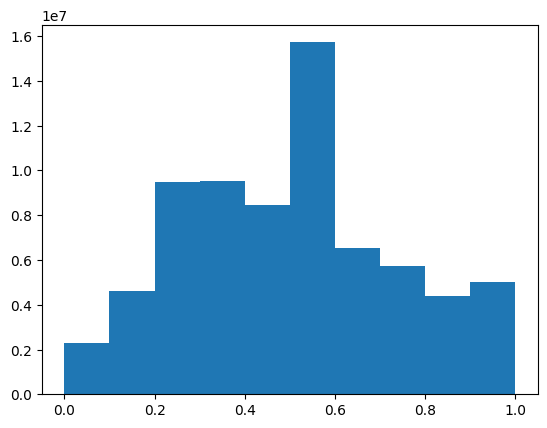

In [49]:
test_popu_df = pd.concat([
    pd.read_csv('../dataprocess/seouldata/floating-population-2017-total.csv', index_col=0),
    pd.read_csv('../dataprocess/seouldata/floating-population-2018-total.csv', index_col=0)
])
test_popu_df = imputed_df(test_popu_df)
test_popu_values = (test_popu_df.values / area_gdf.area.values) @ A.T

TH = 2
ntest_popu_values = (test_popu_values - means) / stds
ntest_popu_values = np.nan_to_num(ntest_popu_values, .5)
ntest_popu_values[(ntest_popu_values > TH)] = TH
ntest_popu_values[(ntest_popu_values < -TH)] = -TH
ntest_popu_values = (ntest_popu_values + TH) / (2*TH)
plt.hist(ntest_popu_values.flatten())

In [50]:
test_popu_df.index = pd.to_datetime(test_popu_df.index)

In [52]:
ntest_popu_values = ntest_popu_values.reshape(-1, 64, 64, 1)

In [53]:
ts = test_popu_df.index
wke = np.eye(7); 
hre = np.eye(24);
TE_test = np.concatenate((wke[ts.weekday], hre[ts.hour]), -1)
# train_TE = TE[:train_data.shape[0]]

CP_test, CQ_test = seq2instance(ntest_popu_values, P_SEQ, Q_SEQ)
TEPQ_test = np.concatenate(seq2instance(TE_test, P_SEQ, Q_SEQ), 1)
CQ_pred = wkmodel.predict((CP_test, TEPQ_test))

548/548 [==============================] - 5s 7ms/step


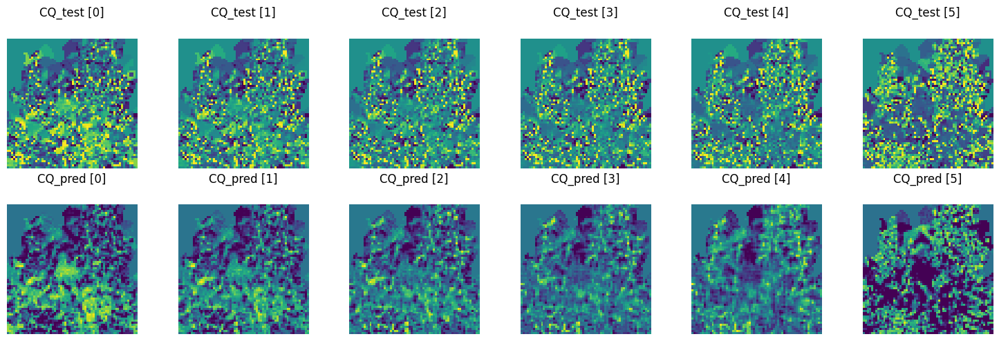

In [54]:
import matplotlib.pyplot as plt

# Set the number of rows and columns for subplots
rows, cols = 2, 6
fig, axes = plt.subplots(rows, cols, figsize=(15, 5))

# Loop through the range and plot each matrix on the corresponding subplot
for i in range(6):
    # Show CQ_test matrix on the first row
    axes[0, i].matshow(CQ_test[10020, i, ..., 0])
    axes[0, i].set_title(f'CQ_test [{i}]')
    axes[0, i].invert_yaxis()
    axes[0, i].axis('off')  # Hide axes

    # Show CQ_pred matrix on the second row
    axes[1, i].matshow(CQ_pred[10020, i, ..., 0])
    axes[1, i].set_title(f'CQ_pred [{i}]')
    axes[1, i].invert_yaxis()
    axes[1, i].axis('off')  # Hide axes

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

In [56]:
batch_size = 64

CP_emb, CQ_emb = [], []
for i in range(0, CP_test.shape[0], batch_size):
    CQ_pred_batch, CP_emb_batch, CQ_emb_batch  = wka_lstm(CP_test[i:i+batch_size], TEPQ_test[i:i+batch_size])
    
    CP_emb.append(CP_emb_batch.numpy())
    CQ_emb.append(CQ_emb_batch.numpy())
    
CP_emb = np.concatenate(CP_emb, 0)
CQ_emb = np.concatenate(CQ_emb, 0)

In [57]:
CPQ = np.concatenate((CP_emb, CQ_emb), 1)

In [58]:
np.save(dataname + f'_WKEMB_ALL_{P_SEQ}-{Q_SEQ}.npy', CPQ)

In [59]:
np.save(dataname + f'_WKEMB_M03_{P_SEQ}-{Q_SEQ}.npy', CPQ[:-sum(3 < test_popu_df.index.month)])
np.save(dataname + f'_WKEMB_M06_{P_SEQ}-{Q_SEQ}.npy', CPQ[sum(popu_df.index.month <= 3):-sum(6 < test_popu_df.index.month)])
np.save(dataname + f'_WKEMB_M09_{P_SEQ}-{Q_SEQ}.npy', CPQ[sum(popu_df.index.month <= 6):-sum(9 < test_popu_df.index.month)])
np.save(dataname + f'_WKEMB_M12_{P_SEQ}-{Q_SEQ}.npy', CPQ[sum(popu_df.index.month <= 9):])